# Human-Mammalian Brain - Basal Ganglia spatial transcriptomic slab coordinates and annotation

The basal ganglia are a set of subcortical structures critical for motor control, particularly in the context of action selection, motor learning and emotional state, whose coarse functional organization is well-described in the literature. Although single-cell RNA-Seq studies have greatly enhanced our understanding of cellular diversity in the brain, the exact spatial distribution of cell types within the brain has been difficult to determine. Using spatial transcriptomics platforms such as MERSCOPE or Xenium enables spatial profiling of hundreds of genes for each cell, enabling mapping of the cells to the [consensus basal ganglia cell type taxonomy](https://alleninstitute.github.io/abc_atlas_access/notebooks/hmba_bg_clustering_analysis_and_annotation.html).

In this notebook, we walk through the data available in this release and show how they are joined together to enable analyses at the cell level.

You need to be connected to the internet to run this notebook and have run through the [getting started notebook](https://alleninstitute.github.io/abc_atlas_access/notebooks/getting_started.html).

In [1]:
import json
import geojson
from typing import List, Tuple, Optional

import pandas as pd
from pathlib import Path
import numpy as np
import matplotlib.pyplot as plt

from abc_atlas_access.abc_atlas_cache.abc_project_cache import AbcProjectCache


We will interact with the data using the **AbcProjectCache**. This cache object tracks which data has been downloaded and serves the path to the requested data on disk. For metadata, the cache can also directly serve up a Pandas DataFrame. See the [``getting_started``](https://alleninstitute.github.io/abc_atlas_access/notebooks/getting_started.html) notebook for more details on using the cache including installing it if it has not already been.

**Change the download_base variable to where you would like to download the data in your system.**

In [2]:
download_base = Path('../../data/abc_atlas')
abc_cache = AbcProjectCache.from_cache_dir(
    download_base,
    s3_bucket='allen-brain-cell-atlas-staging',
    auth_required=True
)

abc_cache.current_manifest

'releases/20250630/manifest.json'

## Data Overview

Below we list the available metadata and expression matrix files available for each species.

The various species in this dataset are divided up by their donor_id and transcriptomic platform. MERSCOPE for Human and Macaque, Xenium for Marmoset.

The mapping between donor to species is:
- Human: H22.30.001
- Macaque: QM23.50.001
- Marmoset: CJ23.56.004

In [3]:
for dataset_name in ['HMBA-MERSCOPE-H22.30.001-BG', 'HMBA-MERSCOPE-QM23.50.001-BG', 'HMBA-Xenium-CJ23.56.004-BG']:
    print(f"Dataset: {dataset_name}")
    metadata_files = abc_cache.list_metadata_files(dataset_name)
    print(f"Metadata files: {metadata_files}")
    expression_matrix_files = abc_cache.list_expression_matrix_files(dataset_name)
    print(f"Expression matrix files: {expression_matrix_files}\n")

Dataset: HMBA-MERSCOPE-H22.30.001-BG
Metadata files: ['ccf_coordinates', 'cell_anatomical_annotations', 'cell_metadata', 'cell_to_cluster_membership_hmba-bg-20250428', 'donor', 'example_gene_expression', 'gene', 'slab_plane_coordinates', 'specimen_metadata', 'value_sets']
Expression matrix files: ['MERSCOPE-H22.30.001-BG-CPT/log2', 'MERSCOPE-H22.30.001-BG/log2', 'MERSCOPE-H22.30.001-BG/raw']

Dataset: HMBA-MERSCOPE-QM23.50.001-BG
Metadata files: ['ccf_coordinates', 'cell_anatomical_annotations', 'cell_metadata', 'cell_to_cluster_membership_hmba-bg-20250428', 'donor', 'donor_coordinates', 'example_gene_expression', 'gene', 'slab_plane_coordinates', 'specimen_metadata', 'value_sets']
Expression matrix files: ['MERSCOPE-QM23.50.001-BG-CPT/log2', 'MERSCOPE-QM23.50.001-BG/log2', 'MERSCOPE-QM23.50.001-BG/raw']

Dataset: HMBA-Xenium-CJ23.56.004-BG
Metadata files: ['ccf_coordinates', 'cell_anatomical_annotations', 'cell_metadata', 'cell_to_cluster_membership_hmba-bg-20250428', 'donor', 'donor_

## Cell metadata

Each species in the HMBA spatial dataset has it's own h5ad files and associated cell metadata tables. We load each of these in turn starting from Human to Macaque to Marmoset. These metadata contain the basic identifiers for each cell and forms the basis by which we will join all other cell level and associated data. Below we load the cell metadata for each species.

Load the Human cells.

In [4]:
human_cell_metadata = abc_cache.get_metadata_dataframe(
    directory='HMBA-MERSCOPE-H22.30.001-BG',
    file_name='cell_metadata',
    dtype={"cell_label": str}
).set_index('cell_label')
human_cell_metadata.head()

,brain_section_label,brain_section_barcode,segmentation_job_id,x_experiment,y_experiment,qc_pass,dataset_label,feature_matrix_label,abc_sample_id
cell_label,,,,,,,,,
1321115602_1-20250227,H22.30.001.CX.16.05.05.03,1321115602,sis_cellpose_v1,3285.3843,336.96967,False,HMBA-MERSCOPE-H22.30.001-BG,MERSCOPE-H22.30.001-BG,NaN
1321115602_2-20250227,H22.30.001.CX.16.05.05.03,1321115602,sis_cellpose_v1,4730.3096,354.69010,False,HMBA-MERSCOPE-H22.30.001-BG,MERSCOPE-H22.30.001-BG,NaN
1321115602_3-20250227,H22.30.001.CX.16.05.05.03,1321115602,sis_cellpose_v1,2966.4824,804.66986,False,HMBA-MERSCOPE-H22.30.001-BG,MERSCOPE-H22.30.001-BG,NaN
1321115602_4-20250227,H22.30.001.CX.16.05.05.03,1321115602,sis_cellpose_v1,3765.8542,704.11170,True,HMBA-MERSCOPE-H22.30.001-BG,MERSCOPE-H22.30.001-BG,90bffbc4-c7d1-44bd-9a04-3780f81777c8
1321115602_5-20250227,H22.30.001.CX.16.05.05.03,1321115602,sis_cellpose_v1,3763.5205,716.22940,True,HMBA-MERSCOPE-H22.30.001-BG,MERSCOPE-H22.30.001-BG,182304c2-65e2-413e-9878-2de05bf4ff2f


Load the Macaque cells.

In [5]:
macaque_cell_metadata = abc_cache.get_metadata_dataframe(
    directory='HMBA-MERSCOPE-QM23.50.001-BG',
    file_name='cell_metadata',
    dtype={"cell_label": str}
).set_index('cell_label')
macaque_cell_metadata.head()

,brain_section_label,brain_section_barcode,segmentation_job_id,x_experiment,y_experiment,qc_pass,dataset_label,feature_matrix_label,abc_sample_id
cell_label,,,,,,,,,
1291813781_1-20250227,QM23.50.001.CX.44.03.07.02,1291813781,sis_cellpose_v1,6328.8564,271.71730,False,HMBA-MERSCOPE-QM23.50.001-BG,MERSCOPE-QM23.50.001-BG,NaN
1291813781_2-20250227,QM23.50.001.CX.44.03.07.02,1291813781,sis_cellpose_v1,6313.3560,297.27830,False,HMBA-MERSCOPE-QM23.50.001-BG,MERSCOPE-QM23.50.001-BG,NaN
1291813781_3-20250227,QM23.50.001.CX.44.03.07.02,1291813781,sis_cellpose_v1,6323.7240,297.38340,False,HMBA-MERSCOPE-QM23.50.001-BG,MERSCOPE-QM23.50.001-BG,NaN
1291813781_4-20250227,QM23.50.001.CX.44.03.07.02,1291813781,sis_cellpose_v1,6370.7470,377.92710,False,HMBA-MERSCOPE-QM23.50.001-BG,MERSCOPE-QM23.50.001-BG,NaN
1291813781_5-20250227,QM23.50.001.CX.44.03.07.02,1291813781,sis_cellpose_v1,6375.0240,386.81006,False,HMBA-MERSCOPE-QM23.50.001-BG,MERSCOPE-QM23.50.001-BG,NaN


Load the Marmoset cells.

In [6]:
marmoset_cell_metadata = abc_cache.get_metadata_dataframe(
    directory='HMBA-Xenium-CJ23.56.004-BG',
    file_name='cell_metadata',
    dtype={"cell_label": str}
).set_index('cell_label')
marmoset_cell_metadata.head()

,brain_section_label,brain_section_barcode,segmentation_job_id,x_experiment,y_experiment,qc_pass,dataset_label,feature_matrix_label,abc_sample_id
cell_label,,,,,,,,,
1382042951_abmkfncc-1-20250227,CJ23.56.004.CX.42.01.06,1382042951,xenium_cell_segmentation_kit_v1,5923.492676,6160.654297,True,HMBA-Xenium-CJ23.56.004-BG,Xenium-CJ23.56.004-BG,c8c08d8c-5147-4d03-b6f4-ca7bf4d0b8d1
1382042951_abmmdgea-1-20250227,CJ23.56.004.CX.42.01.06,1382042951,xenium_cell_segmentation_kit_v1,6137.572266,6217.075684,True,HMBA-Xenium-CJ23.56.004-BG,Xenium-CJ23.56.004-BG,f10bad2c-9cc7-44bf-bd7e-4e61d28121bd
1382042951_abmojfce-1-20250227,CJ23.56.004.CX.42.01.06,1382042951,xenium_cell_segmentation_kit_v1,5802.674805,5614.007812,True,HMBA-Xenium-CJ23.56.004-BG,Xenium-CJ23.56.004-BG,080466ff-3dea-44f1-b6e2-7892e8c12c95
1382042951_abmomnim-1-20250227,CJ23.56.004.CX.42.01.06,1382042951,xenium_cell_segmentation_kit_v1,5805.942383,5599.325684,True,HMBA-Xenium-CJ23.56.004-BG,Xenium-CJ23.56.004-BG,cee3bf8b-a159-42d1-983a-ac149b9edda9
1382042951_aeiamgga-1-20250227,CJ23.56.004.CX.42.01.06,1382042951,xenium_cell_segmentation_kit_v1,6291.268066,6068.720215,True,HMBA-Xenium-CJ23.56.004-BG,Xenium-CJ23.56.004-BG,3f24c46e-9ab1-4a54-a6fc-591f752edb48


### Specimen metadata

In order to associate each cell to the associated specimen in comes from, we load the specimen table for each species. This provides a mapping for each cell to the specimen/tissue/brain section it originates from. It also allows us to associate the cell to its associated `slab_plane` through the specimen id. We'll explain more regarding the `slab_plane` when we load the our cells coordinates in the plane.

Below we load the Human specimen data.

In [7]:
human_specimen = abc_cache.get_metadata_dataframe(
    directory='HMBA-MERSCOPE-H22.30.001-BG',
    file_name='specimen_metadata',
    dtype={"cell_label": str}
).set_index('brain_section_label')
human_specimen.head()

,brain_section_barcode,brain_section_thickness,brain_section_plane_of_section,brain_section_ordinal,brain_section_depth,section_set_label,section_set_ordinal,section_set_base_ordinal,brain_block_label,brain_block_number,brain_slab_label,brain_slab_ordinal,brain_slab_thickness,hemisphere,brain_division_label,brain_division_ordinal,donor_label,slab_plane_ordinal,slab_plane_label,slab_plane_order
brain_section_label,,,,,,,,,,,,,,,,,,,,
H22.30.001.BS.3.01.01.02,1327888285,14,transverse (rostral to caudal),74,1036,H22.30.001.BS.3.01.01,1,72,H22.30.001.BS.3.01,1,H22.30.001.BS.3,2,4.0,right,H22.30.001.BS,2,H22.30.001,1,H22.30.001.BS.3.Plane.01,20201
H22.30.001.BS.3.01.03.02,1327888566,14,transverse (rostral to caudal),109,1526,H22.30.001.BS.3.01.03,3,107,H22.30.001.BS.3.01,1,H22.30.001.BS.3,2,4.0,right,H22.30.001.BS,2,H22.30.001,3,H22.30.001.BS.3.Plane.03,20203
H22.30.001.BS.3.02.01.02,1327890979,14,transverse (rostral to caudal),37,518,H22.30.001.BS.3.02.01,1,35,H22.30.001.BS.3.02,2,H22.30.001.BS.3,2,4.0,right,H22.30.001.BS,2,H22.30.001,1,H22.30.001.BS.3.Plane.01,20201
H22.30.001.BS.3.02.03.03,1327891526,14,transverse (rostral to caudal),146,2044,H22.30.001.BS.3.02.03,3,143,H22.30.001.BS.3.02,2,H22.30.001.BS.3,2,4.0,right,H22.30.001.BS,2,H22.30.001,3,H22.30.001.BS.3.Plane.03,20203
H22.30.001.CX.13.01.03.02,1304618482,10,coronal (caudal to rostral),143,1430,H22.30.001.CX.13.01.03,3,141,H22.30.001.CX.13.01,1,H22.30.001.CX.13,13,4.0,right,H22.30.001.CX,1,H22.30.001,5,H22.30.001.CX.13.Plane.05,11305


The Macaque specimen table.

In [8]:
macaque_specimen = abc_cache.get_metadata_dataframe(
    directory='HMBA-MERSCOPE-QM23.50.001-BG',
    file_name='specimen_metadata',
    dtype={"cell_label": str}
).set_index('brain_section_label')
macaque_specimen.head()

,brain_section_barcode,brain_section_thickness,brain_section_plane_of_section,brain_section_ordinal,brain_section_depth,section_set_label,section_set_ordinal,section_set_base_ordinal,brain_block_label,brain_block_number,brain_slab_label,brain_slab_ordinal,brain_slab_thickness,hemisphere,brain_division_label,brain_division_ordinal,donor_label,slab_plane_ordinal,slab_plane_label,slab_plane_order
brain_section_label,,,,,,,,,,,,,,,,,,,,
QM23.50.001.CX.42.01.03.02,1291809823,10,coronal (caudal to rostral),133,1330,QM23.50.001.CX.42.01.03,3,131,QM23.50.001.CX.42.01,1,QM23.50.001.CX.42,42,4.0,right,QM23.50.001.CX,1,QM23.50.001,5,QM23.50.001.CX.42.Plane.05,14205
QM23.50.001.CX.42.01.05.03,1291809799,10,coronal (caudal to rostral),234,2340,QM23.50.001.CX.42.01.05,5,231,QM23.50.001.CX.42.01,1,QM23.50.001.CX.42,42,4.0,right,QM23.50.001.CX,1,QM23.50.001,3,QM23.50.001.CX.42.Plane.03,14203
QM23.50.001.CX.42.02.03.02,1291810606,10,coronal (caudal to rostral),134,1340,QM23.50.001.CX.42.02.03,3,132,QM23.50.001.CX.42.02,2,QM23.50.001.CX.42,42,4.0,right,QM23.50.001.CX,1,QM23.50.001,5,QM23.50.001.CX.42.Plane.05,14205
QM23.50.001.CX.42.02.05.03,1291810584,10,coronal (caudal to rostral),234,2340,QM23.50.001.CX.42.02.05,5,231,QM23.50.001.CX.42.02,2,QM23.50.001.CX.42,42,4.0,right,QM23.50.001.CX,1,QM23.50.001,3,QM23.50.001.CX.42.Plane.03,14203
QM23.50.001.CX.42.02.07.03,1291810555,10,coronal (caudal to rostral),334,3340,QM23.50.001.CX.42.02.07,7,331,QM23.50.001.CX.42.02,2,QM23.50.001.CX.42,42,4.0,right,QM23.50.001.CX,1,QM23.50.001,1,QM23.50.001.CX.42.Plane.01,14201


And finally the Marmoset specimen table.

In [9]:
marmoset_specimen = abc_cache.get_metadata_dataframe(
    directory='HMBA-Xenium-CJ23.56.004-BG',
    file_name='specimen_metadata',
    dtype={"cell_label": str}
).set_index('brain_section_label')
marmoset_specimen.head()

,brain_section_barcode,brain_section_thickness,brain_section_plane_of_section,brain_section_ordinal,brain_section_depth,section_set_label,section_set_ordinal,section_set_base_ordinal,brain_block_label,brain_block_number,brain_slab_label,brain_slab_ordinal,brain_slab_thickness,hemisphere,brain_division_label,brain_division_ordinal,donor_label,slab_plane_ordinal,slab_plane_label,slab_plane_order
brain_section_label,,,,,,,,,,,,,,,,,,,,
CJ23.56.004.CX.42.01.06,1382042951,10,coronal (rostral to caudal),7,70,CJ23.56.004.CX.42.01,1,1,CJ23.56.004.CX.42,42,CJ23.56.004.CX.42,42,5.0,right,CJ23.56.004.CX,1,CJ23.56.004,1,CJ23.56.004.CX.42.Plane.01,14201
CJ23.56.004.CX.42.02.06,1382042748,10,coronal (rostral to caudal),27,270,CJ23.56.004.CX.42.02,2,21,CJ23.56.004.CX.42,42,CJ23.56.004.CX.42,42,5.0,right,CJ23.56.004.CX,1,CJ23.56.004,2,CJ23.56.004.CX.42.Plane.02,14202
CJ23.56.004.CX.42.03.07,1382042618,10,coronal (rostral to caudal),48,480,CJ23.56.004.CX.42.03,3,41,CJ23.56.004.CX.42,42,CJ23.56.004.CX.42,42,5.0,right,CJ23.56.004.CX,1,CJ23.56.004,3,CJ23.56.004.CX.42.Plane.03,14203
CJ23.56.004.CX.42.04.06,1382042399,10,coronal (rostral to caudal),67,670,CJ23.56.004.CX.42.04,4,61,CJ23.56.004.CX.42,42,CJ23.56.004.CX.42,42,5.0,right,CJ23.56.004.CX,1,CJ23.56.004,4,CJ23.56.004.CX.42.Plane.04,14204
CJ23.56.004.CX.42.05.06,1382042114,10,coronal (rostral to caudal),87,870,CJ23.56.004.CX.42.05,5,81,CJ23.56.004.CX.42,42,CJ23.56.004.CX.42,42,5.0,right,CJ23.56.004.CX,1,CJ23.56.004,5,CJ23.56.004.CX.42.Plane.05,14205


Join the specimen tables with the cell metadata for each species.

In [10]:
macaque_cell_metadata = macaque_cell_metadata.join(macaque_specimen, on='brain_section_label', rsuffix='_specimen')
marmoset_cell_metadata = marmoset_cell_metadata.join(marmoset_specimen, on='brain_section_label', rsuffix='_specimen')
human_cell_metadata = human_cell_metadata.join(human_specimen, on='brain_section_label', rsuffix='_specimen')

# clean up memory
del macaque_specimen
del marmoset_specimen
del human_specimen

## Spatial, slab-plane coordinates

We load the slab-plane coordinates for all of our cells. Each cell comes from a brain section that is a slice of a block cut from a cross-sectional slab of brain. The brain sections are spatially registered with sections from the neighboring blocks within the brain slab. These associated brain sections are referred to a slab-plane. This slab-plane coordinate system in millimeters are the coordinates we will plot all of our cells in this notebook.

Again, we load the coordinates for each of the 3 different species.

In [11]:
human_cell_slab_plane_coordinates = abc_cache.get_metadata_dataframe(
    directory='HMBA-MERSCOPE-H22.30.001-BG',
    file_name='slab_plane_coordinates',
    dtype={"cell_label": str}
).set_index('cell_label')
human_cell_slab_plane_coordinates.head()

,slab_plane_label,x_slab_mm,y_slab_mm
cell_label,,,
1321115602_1-20250227,H22.30.001.CX.16.Plane.05,19.435099,77.464922
1321115602_2-20250227,H22.30.001.CX.16.Plane.05,18.956184,76.119954
1321115602_3-20250227,H22.30.001.CX.16.Plane.05,19.982788,77.581815
1321115602_4-20250227,H22.30.001.CX.16.Plane.05,19.614409,76.879852
1321115602_5-20250227,H22.30.001.CX.16.Plane.05,19.626566,76.877390


In [12]:
macaque_cell_slab_plane_coordinates = abc_cache.get_metadata_dataframe(
    directory='HMBA-MERSCOPE-QM23.50.001-BG',
    file_name='slab_plane_coordinates',
    dtype={"cell_label": str}
).set_index('cell_label')
macaque_cell_slab_plane_coordinates.head()

,slab_plane_label,x_slab_mm,y_slab_mm
cell_label,,,
1291813781_1-20250227,QM23.50.001.CX.44.Plane.07,49.982522,35.779509
1291813781_2-20250227,QM23.50.001.CX.44.Plane.07,49.986300,35.748134
1291813781_3-20250227,QM23.50.001.CX.44.Plane.07,49.976306,35.751906
1291813781_4-20250227,QM23.50.001.CX.44.Plane.07,49.896221,35.688888
1291813781_5-20250227,QM23.50.001.CX.44.Plane.07,49.888261,35.681598


In [13]:
marmoset_cell_slab_plane_coordinates = abc_cache.get_metadata_dataframe(
    directory='HMBA-Xenium-CJ23.56.004-BG',
    file_name='slab_plane_coordinates',
    dtype={"cell_label": str}
).set_index('cell_label')
marmoset_cell_slab_plane_coordinates.head()

,brain_section_label,x_rotated,y_rotated,slab_plane_label,x_slab_mm,y_slab_mm
cell_label,,,,,,
1382042951_abmkfncc-1-20250227,CJ23.56.004.CX.42.01.06,2935.931563,-7974.969447,CJ23.56.004.CX.42.Plane.01,22.351041,13.197057
1382042951_abmmdgea-1-20250227,CJ23.56.004.CX.42.01.06,2760.454341,-8109.955328,CJ23.56.004.CX.42.Plane.01,22.161344,13.311199
1382042951_abmojfce-1-20250227,CJ23.56.004.CX.42.01.06,2835.431429,-7424.225350,CJ23.56.004.CX.42.Plane.01,22.313860,12.638454
1382042951_abmomnim-1-20250227,CJ23.56.004.CX.42.01.06,2826.728643,-7411.957363,CJ23.56.004.CX.42.Plane.01,22.306610,12.625276
1382042951_aeiamgga-1-20250227,CJ23.56.004.CX.42.01.06,2561.271672,-8032.767191,CJ23.56.004.CX.42.Plane.01,21.972238,13.211848


And finally we join each species into their respective cell metadata.

In [14]:
human_cell_metadata = human_cell_metadata.join(
    human_cell_slab_plane_coordinates[['x_slab_mm', 'y_slab_mm']], how='inner'
)
macaque_cell_metadata = macaque_cell_metadata.join(
    macaque_cell_slab_plane_coordinates[['x_slab_mm', 'y_slab_mm']], how='inner'
)
marmoset_cell_metadata = marmoset_cell_metadata.join(
    marmoset_cell_slab_plane_coordinates[['x_slab_mm', 'y_slab_mm']], how='inner'
)

# clean up memory
del human_cell_slab_plane_coordinates
del macaque_cell_slab_plane_coordinates
del marmoset_cell_slab_plane_coordinates

### Geojson polygons

The dataset includes polygons outlining select regions of the Basal Ganglia, which can be plotted over slab coordinates. These polygon annotations were manually drawn using a combination of taxonomy cell types, select gene expression from the spatial transcriptomics gene panel, and cell segmentation stains with best attempts made to be consistent across species and planes. Manual annotations include the striatum (STR; encompasses the caudate, putamen, nucleus accumbens, and olfactory tubercle), the globus pallidus (GP) and it's nested subregions the external (GPe) and internal (GPi) segments, the ventral pallidum (VeP), the substantia nigra (SN), and the subthalamic nucleus (STH). However, please note that these polygons are not derived from registration to the Harmonized Ontology of Mammalian Brain Anatomy (HOMBA). They should instead be used as cellular groupings to orient the user in the anatomical context of the spatial transcriptomics data and subset the data into more manageable, anatomically-related chunks. These polygons are provided in [geojson](https://geojson.org/) format, and here we use the associated geojson python package to load the jsons for use in our visualization.

First though, we load the term set for these data. While these geojsons are manually drawn and not derived from the HOMBA, we do use the abbreviations and colors associated with these structures through their DHBA identifier when such an identifier exists. These colorings match those of the previous [HMBA-BG 10X tutorial](https://alleninstitute.github.io/abc_atlas_access/notebooks/hmba_bg_clustering_analysis_and_annotation.html). We load these colors and identifiers below.

In [15]:
value_sets = abc_cache.get_metadata_dataframe(
    directory='HMBA-MERSCOPE-H22.30.001-BG',
    file_name='value_sets',
)
pred = value_sets['field'] == 'parcellation_term_symbol'
parcellation_terms = value_sets[pred].copy()
parcellation_terms.set_index('label', inplace=True)
parcellation_terms

,table,field,description,order,external_identifier,parent_label,color_hex_triplet
label,,,,,,,
Basal ganglia and adjacent,path,parcellation_term_symbol,Basal ganglia and adjacent,1,basal_ganglia_and_adjacent,NaN,#808080
Subcortical,path,parcellation_term_symbol,Subcortical,2,subcortical,NaN,#E0E0E0
Midline,path,parcellation_term_symbol,Midline,3,midline,NaN,#E3BE8A
STR,path,parcellation_term_symbol,striatum,4,DHBA:10333,Basal ganglia and adjacent,#cd86cc
Ca,path,parcellation_term_symbol,caudate nucleus,5,DHBA:10334,NaN,#ff6b9a
Pu,path,parcellation_term_symbol,putamen,6,DHBA:10338,NaN,#9BA2FF
GP,path,parcellation_term_symbol,globus pallidus,7,DHBA:10342,Basal ganglia and adjacent,#7AE361
GPe,path,parcellation_term_symbol,external segment of globus pallidus,8,DHBA:10343,Basal ganglia and adjacent,#53DB33
GPi,path,parcellation_term_symbol,internal segment of globus pallidus,9,DHBA:10344,Basal ganglia and adjacent,#A7DB33


We define two functions that will be used in our plotting of the geojsons. The first overplots the geojson over the specified plot, handling the different kinds of geojson shapes/polygons. The second loads the data based on the appropriate slab and species provided.

In [16]:
def plot_geo_data(geo_data: dict, ax: plt.Axes, terms=parcellation_terms):
    """Plot a geojson polygon over the input axis.

    Parameters
    ----------
    geo_data: dict
        Geojson formatted dictionary containing Polygons to plot.
    ax: matplotlib.pyplot.axis
        Axis object to plot the geojson data over.
    terms: pandas.DataFrame
        Term list containing the colors and orders for the parcellation, brain region terms. 
    """
    if geo_data is None:
        return None
    # If the geo_data is a FeatureCollection, we need to iterate over its
    # features and plot each one.
    if geo_data['type'] == 'FeatureCollection':
        for sub_data in geo_data['features']:
            plot_geo_data(sub_data, ax)
    elif geo_data['type'] == 'Feature':
        geometry_data = geo_data['geometry']
        name = geo_data['properties']['label']
        color = terms.loc[name, 'color_hex_triplet'] # Get the color for this object from the term list.
        # If the geometry is a GeometryCollection, we need to iterate over its
        # geometries that make up the complete feature.
        if geometry_data['type'] == 'GeometryCollection':
            for idx, geometry in enumerate(geometry_data['geometries']):
                coords = np.array(list(geojson.coords(geometry)))
                # Only label the first geometry in the collection. Others
                # will be plotted without a label to avoid duplicate legend entries.
                if idx == 0:
                    ax.fill(coords[:, 0],
                            coords[:, 1],
                            edgecolor=color,
                            fill=False,
                            linewidth=3,
                            label=name)
                else:
                    ax.fill(coords[:, 0],
                            coords[:, 1],
                            edgecolor=color,
                            fill=False,
                            linewidth=3)
        else:
            coords = np.array(list(geojson.coords(geometry_data)))
            try:
                ax.fill(coords[:, 0],
                        coords[:, 1],
                        edgecolor=color,
                        fill=False,
                        linewidth=3,
                        label=name)
            except ValueError as e:
                import pdb; pdb.set_trace()
    else:
        print("unknown data", geo_data)

def get_polygons(slab_name: str, species: str) -> dict:
    """Load the geojson polygons for the specified slab and species.

    Parameters
    ----------
    slab_name: str
        Name of the slab to load.
    species: str
        Species of the slab, one of 'macaque', 'marmoset', or 'human'.

    Returns
    -------
    dict
        Geojson formatted dictionary containing the polygons for the specified slab and species.
    """

    if species == 'macaque':
        base_dir = 'HMBA-MERSCOPE-QM23.50.001-BG'
    elif species == 'marmoset':
        base_dir = 'HMBA-Xenium-CJ23.56.004-BG'
    elif species == 'human':
        base_dir = 'HMBA-MERSCOPE-H22.30.001-BG'
    else:
        raise ValueError('Invalid species')

    file_path = abc_cache.get_file_path(directory=base_dir, file_name=slab_name)
    if not file_path.exists():
        return None

    with open(file_path) as jfile:
        data = json.load(jfile)
    
    return data

## Manual anatomical annotations

Using the manually drawn anatomical polygons described above, each cell was assigned membership in the annotated anatomical regions. The tables we load below contain boolean columns denoting which anatomical regions the cell could be considered a member of. Note that a given cell can belong to multiple different anatomical annotations as the polygons overlap and can be subsets of each other. For instance, all cells in this release are within the "Basal Ganglia and adjacent" annotation, and most cells in either "GPe" or "GPi" are within the parent annotation "GP". The final column, ``parcellation_term_symbol`` is a single value representing a single unique assignment to a structure based on selecting from STH in reverse order of the columns, keeping the first True assignment. For this notebook, we will use only the ``parcellation_term_symbol`` to plot our data.

In [17]:
human_cell_anatomical_annotations = abc_cache.get_metadata_dataframe(
    directory='HMBA-MERSCOPE-H22.30.001-BG',
    file_name='cell_anatomical_annotations'
).set_index('cell_label')
human_cell_anatomical_annotations.head()

,Basal ganglia and adjacent,STR,GP,GPe,GPi,VeP,SN,STH,parcellation_term_symbol
cell_label,,,,,,,,,
1321115602_1-20250227,True,True,False,False,False,False,False,False,STR
1321115602_2-20250227,True,True,False,False,False,False,False,False,STR
1321115602_3-20250227,True,True,False,False,False,False,False,False,STR
1321115602_4-20250227,True,True,False,False,False,False,False,False,STR
1321115602_5-20250227,True,True,False,False,False,False,False,False,STR


In [18]:
macaque_cell_anatomical_annotations = abc_cache.get_metadata_dataframe(
    directory='HMBA-MERSCOPE-QM23.50.001-BG',
    file_name='cell_anatomical_annotations'
).set_index('cell_label')
macaque_cell_anatomical_annotations.head()

,Basal ganglia and adjacent,STR,GP,GPe,GPi,VeP,SN,STH,parcellation_term_symbol
cell_label,,,,,,,,,
1291813781_1-20250227,True,False,False,False,False,False,False,False,Basal ganglia and adjacent
1291813781_2-20250227,True,False,False,False,False,False,False,False,Basal ganglia and adjacent
1291813781_3-20250227,True,False,False,False,False,False,False,False,Basal ganglia and adjacent
1291813781_4-20250227,True,False,False,False,False,False,False,False,Basal ganglia and adjacent
1291813781_5-20250227,True,False,False,False,False,False,False,False,Basal ganglia and adjacent


In [19]:
marmoset_cell_anatomical_annotations = abc_cache.get_metadata_dataframe(
    directory='HMBA-Xenium-CJ23.56.004-BG',
    file_name='cell_anatomical_annotations'
).set_index('cell_label')
marmoset_cell_anatomical_annotations.head()

,Basal ganglia and adjacent,STR,GP,GPe,GPi,VeP,SN,STH,parcellation_term_symbol
cell_label,,,,,,,,,
1382042951_abmkfncc-1-20250227,True,False,False,False,False,False,False,False,Basal ganglia and adjacent
1382042951_abmmdgea-1-20250227,True,False,False,False,False,False,False,False,Basal ganglia and adjacent
1382042951_abmojfce-1-20250227,True,False,False,False,False,False,False,False,Basal ganglia and adjacent
1382042951_abmomnim-1-20250227,True,False,False,False,False,False,False,False,Basal ganglia and adjacent
1382042951_aeiamgga-1-20250227,True,True,False,False,False,False,False,False,STR


Below, we define a function to extract color and order information from the ``value_set`` table for each anatomical parcellation term. This will allow us to plot the color of the anatomical region we assigned each cell to using the manually drawn, geojson polygons.

In [20]:
def extract_value_set(cell_metadata_df: pd.DataFrame, input_value_set: pd.DataFrame, input_value_set_label: str):
    """Add color and order columns to the cell metadata dataframe based on the input
    value set.

    Columns are added as {input_value_set_label}_color and {input_value_set_label}_order.

    Parameters
    ----------
    cell_metadata_df : pd.DataFrame
        DataFrame containing cell metadata.
    input_value_set : pd.DataFrame
        DataFrame containing the value set information.
    input_value_set_label : str
        The the column name to extract color and order information for. will be added to the cell metadata.
    """
    cell_metadata_df[f'{input_value_set_label}_color'] = input_value_set[
        input_value_set['field'] == input_value_set_label
    ].loc[cell_metadata_df[input_value_set_label]]['color_hex_triplet'].values
    cell_metadata_df[f'{input_value_set_label}_order'] = input_value_set[
        input_value_set['field'] == input_value_set_label
    ].loc[cell_metadata_df[input_value_set_label]]['order'].values

Merge the manual annotation information into the cell meatadata tables and add in the color and ordering information.

In [21]:
human_cell_metadata = human_cell_metadata.join(
    human_cell_anatomical_annotations[['parcellation_term_symbol']]
)
macaque_cell_metadata = macaque_cell_metadata.join(
    macaque_cell_anatomical_annotations[['parcellation_term_symbol']]
)
marmoset_cell_metadata = marmoset_cell_metadata.join(
    marmoset_cell_anatomical_annotations[['parcellation_term_symbol']]
)
extract_value_set(human_cell_metadata, parcellation_terms, 'parcellation_term_symbol')
extract_value_set(macaque_cell_metadata, parcellation_terms, 'parcellation_term_symbol')
extract_value_set(marmoset_cell_metadata, parcellation_terms, 'parcellation_term_symbol')

human_cell_metadata = human_cell_metadata.sort_values(by='parcellation_term_symbol_order')
macaque_cell_metadata = macaque_cell_metadata.sort_values(by='parcellation_term_symbol_order')
marmoset_cell_metadata = marmoset_cell_metadata.sort_values(by='parcellation_term_symbol_order')

# clean up memory
del human_cell_anatomical_annotations
del macaque_cell_anatomical_annotations
del marmoset_cell_anatomical_annotations

## Plotting the Slabs

We define a helper function *plot_slabs* to visualize the cells for a specified set of slabs either by colorized metadata or gene expression. The code also allows for plotting the annotation polygons over the data if requested. This function can be used to plot individual frames as well.

In [22]:
def plot_slabs(
    df: pd.DataFrame,
    feature: str,
    slab_list: List[str],
    species: str,
    cmap: Optional[plt.Colormap] = None,
    fig_width: float = 40,
    fig_height: float = 8,
    plot_polygons: bool = False,
    point_size: float = 1.0,
    fix_bounds: bool = False
) -> Tuple[plt.Figure, np.ndarray]:
    """Plot spatial transcriptomics data.

    Parameters
    ----------
    df: pandas.DataFrame
        cell metadata data frame with x,y locations to plot.
    feature: str
        Expression value or color column to plot.
    slab_list: List[str]
        List of slab_plane ids to plot.
    species: str
        Species to plot (human, macaque, marmoset).
    cmap: matplotlib.colors.Colormap
        Colormap for expression features.
    fig_width: int
        Width of the plotted figure.
    fig_height: int
        Height of the plotted figure.
    plot_polygons: bool
        Overplot geojson polygons. Note that these are note available for human
        and this should be set to False.
    point_size: float
        Size of the points to plot.
    fix_bounds: bool
        If True, fix the x and y bounds across all slabs to be the same.
    """
    if isinstance(slab_list, str):
        slab_list = [slab_list]

    fig, ax = plt.subplots(1, len(slab_list))
    fig.set_size_inches(fig_width, fig_height)

    if len(slab_list) == 1:
        ax = [ax]

    if 'x' in df.columns:
        x_col = 'x'
    elif 'x_slab_mm' in df.columns:
        x_col = 'x_slab_mm'
    if 'y' in df.columns:
        y_col = 'y'
    elif 'y_slab_mm' in df.columns:
        y_col = 'y_slab_mm'

    if fix_bounds:
        x_min = df[x_col].min()
        x_max = df[x_col].max()
        y_min = df[y_col].min()
        y_max = df[y_col].max()
    
    for idx, slab in enumerate(slab_list):

        if 'slab_plane_label' in df.columns:
            filtered = df[df['slab_plane_label'] == slab]
        elif 'brain_section_label' in df.columns:
            filtered = df[df['brain_section_label'] == slab]
        
        xx = filtered[x_col]
        yy = filtered[y_col]
        vv = filtered[feature]
        
        if cmap is not None:
            ax[idx].scatter(xx, yy, s=point_size, c=vv, marker='.', cmap=cmap)
        else:
            ax[idx].scatter(xx, yy, s=point_size, c=vv, marker=".")

        if plot_polygons:
            plot_geo_data(get_polygons(slab, species=species), ax[idx])
            
        ax[idx].axis('equal')
        ylim = ax[idx].get_ylim()
        if fix_bounds:
            ylim = (y_min, y_max)
            ax[idx].set_xlim(x_min, x_max)
        ax[idx].set_ylim(ylim[1], ylim[0])
        ax[idx].set_xticks([])
        ax[idx].set_yticks([])
        
        ax[idx].set_title(slab)
        ax[idx].legend(loc=0)
        
    plt.subplots_adjust(wspace=0.01, hspace=0.01)
    return fig, ax

### Displaying the manual anatomical annotations.

We now have a set of cells in x,y slab coordinates and metadata on the anatomical regions these cells have been manually annotated as members of. Below we plot the cells using the colors as defined in our term set, displaying the cells by manually annotated regions of the Basal Ganglia.

/var/folders/kc/7glrmt5n67x16yj_tg86t49c0000gp/T/ipykernel_56927/2850780716.py:92: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax[idx].legend(loc=0)


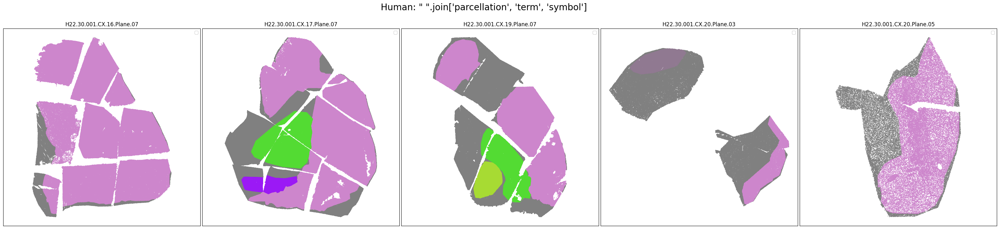

In [23]:
human_slab_list = [
    'H22.30.001.CX.16.Plane.07', 'H22.30.001.CX.17.Plane.07',
    'H22.30.001.CX.19.Plane.07', 'H22.30.001.CX.20.Plane.03', 'H22.30.001.CX.20.Plane.05'
]
color_type = 'parcellation_term_symbol_color'
fig, ax = plot_slabs(
    human_cell_metadata,
    color_type,
    human_slab_list,
    species='human',
    plot_polygons=False
)
fig.suptitle(f'Human: " ".join{color_type.split("_")[0:-1]}', size=20)
plt.show()

/var/folders/kc/7glrmt5n67x16yj_tg86t49c0000gp/T/ipykernel_56927/2850780716.py:92: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax[idx].legend(loc=0)


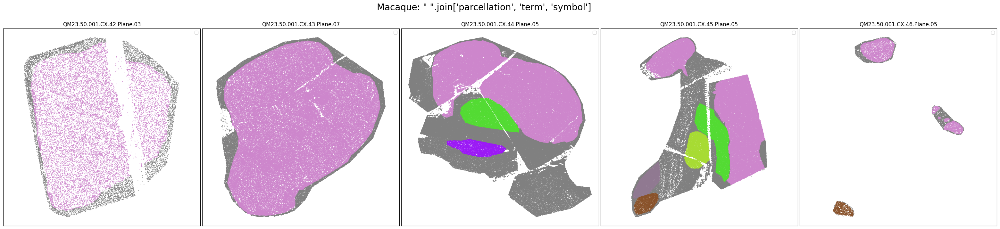

In [24]:
macaque_slab_list = [
    'QM23.50.001.CX.42.Plane.03', 'QM23.50.001.CX.43.Plane.07', 'QM23.50.001.CX.44.Plane.05',
    'QM23.50.001.CX.45.Plane.05', 'QM23.50.001.CX.46.Plane.05'
]
color_type = 'parcellation_term_symbol_color'
fig, ax = plot_slabs(
    macaque_cell_metadata,
    color_type,
    macaque_slab_list,
    species='macaque',
    plot_polygons=False
)
fig.suptitle(f'Macaque: " ".join{color_type.split("_")[0:-1]}', size=20)
plt.show()

/var/folders/kc/7glrmt5n67x16yj_tg86t49c0000gp/T/ipykernel_56927/2850780716.py:92: UserWarning: No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.
  ax[idx].legend(loc=0)


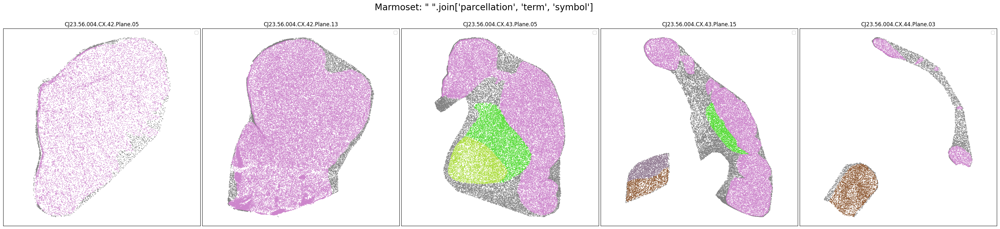

In [25]:
marmoset_slab_list = [
    'CJ23.56.004.CX.42.Plane.05', 'CJ23.56.004.CX.42.Plane.13', 'CJ23.56.004.CX.43.Plane.05',
    'CJ23.56.004.CX.43.Plane.15', 'CJ23.56.004.CX.44.Plane.03'
]
color_type = 'parcellation_term_symbol_color'
fig, ax = plot_slabs(
    marmoset_cell_metadata,
    color_type,
    marmoset_slab_list,
    species='marmoset',
    plot_polygons=False
)
fig.suptitle(f'Marmoset: " ".join{color_type.split("_")[0:-1]}', size=20)
plt.show()

## Taxonomy mapping

Now that we have our base functions for plotting set up and we've exercised them using the parcellation colors, let's load the taxonomy information so that we can plot the spatial locations of various cell types. Below, we load and merge all the information we need to plot cell colors and taxonomy as done in the [previous HMBA-BG tutorials](https://alleninstitute.github.io/abc_atlas_access/notebooks/hmba_bg_clustering_analysis_and_annotation.html).

In [26]:
cluster = abc_cache.get_metadata_dataframe(
    directory='HMBA-BG-taxonomy-CCN20250428',
    file_name='cluster',
    dtype={'number_of_cells': 'Int64'}
).rename(columns={'label': 'cluster_annotation_term_label'}).set_index('cluster_annotation_term_label')
cluster_annotation_term_set = abc_cache.get_metadata_dataframe(
    directory='HMBA-BG-taxonomy-CCN20250428',
    file_name='cluster_annotation_term_set'
).rename(columns={'label': 'cluster_annotation_term_label'})

cluster_annotation_term = abc_cache.get_metadata_dataframe(
    directory='HMBA-BG-taxonomy-CCN20250428',
    file_name='cluster_annotation_term',
).rename(columns={'label': 'cluster_annotation_term_label'}).set_index('cluster_annotation_term_label')

cluster_to_cluster_annotation_membership = abc_cache.get_metadata_dataframe(
    directory='HMBA-BG-taxonomy-CCN20250428',
    file_name='cluster_to_cluster_annotation_membership',
).set_index('cluster_annotation_term_label')
membership_with_cluster_info = cluster_to_cluster_annotation_membership.join(
    cluster.reset_index().set_index('cluster_alias')[['number_of_cells']],
    on='cluster_alias'
)
membership_with_cluster_info = membership_with_cluster_info.join(cluster_annotation_term, rsuffix='_anno_term').reset_index()
membership_groupby = membership_with_cluster_info.groupby(
    ['cluster_alias', 'cluster_annotation_term_set_name']
)

cluster_annotation_term_set = abc_cache.get_metadata_dataframe(
    directory='HMBA-BG-taxonomy-CCN20250428',
    file_name='cluster_annotation_term_set'
).rename(columns={'label': 'cluster_annotation_term_label'})

# term_sets = abc_cache.get_metadata_dataframe(directory='WHB-taxonomy', file_name='cluster_annotation_term_set').set_index('label')
cluster_details = membership_groupby['cluster_annotation_term_name'].first().unstack()
cluster_order = membership_groupby['term_order'].first().unstack()
cluster_order.sort_values(['Neighborhood', 'Class', 'Subclass', 'Group', 'Cluster'], inplace=True)
cluster_order.rename(
    columns={'Neighborhood': 'Neighborhood_order',
             'Class': 'Class_order',
             'Subclass': 'Subclass_order',
             'Group': 'Group_order',
             'Cluster': 'Cluster_order'},
    inplace=True
)

cluster_colors = membership_groupby['color_hex_triplet'].first().unstack()
cluster_colors = cluster_colors[cluster_annotation_term_set['name']]
cluster_colors.sort_values(
    ['Neighborhood', 'Class', 'Subclass', 'Group', 'Cluster'],
    inplace=True
)

Each of the three species has been mapped to the HMBA 10X taxonomy using MapMyCells. Below, we load the mapping of each cell to a taxonomy cluster. This mapping is the entry point into the taxonomy.

Again, we load each species.

In [27]:
human_cell_to_cluster = abc_cache.get_metadata_dataframe(
    directory='HMBA-MERSCOPE-H22.30.001-BG',
    file_name='cell_to_cluster_membership_hmba-bg-20250428'
).set_index('cell_label')

macaque_cell_to_cluster = abc_cache.get_metadata_dataframe(
    directory='HMBA-MERSCOPE-QM23.50.001-BG',
    file_name='cell_to_cluster_membership_hmba-bg-20250428',
).set_index('cell_label')

marmoset_cell_to_cluster = abc_cache.get_metadata_dataframe(
    directory='HMBA-Xenium-CJ23.56.004-BG',
    file_name='cell_to_cluster_membership_hmba-bg-20250428',
).set_index('cell_label')

The spatial data are registered to an extended version of the taxonomy that contains clusters that are considered Adjacent to the Basal Ganglia. These are cell types that are present in the data but are not considered part of the basal ganglia. These clusters are mapped into a Group, Subclass, Class, and Neighborhood in a single path of the taxonomy called Adjacent. The release consensus taxonomy does not explicitly contain this taxon. Any cell in a cluster that would be annotated into Adjacent, will end up being NaN in the joins between the clusters and the taxonomy.  We thus fill in these NaNs, assigning any cell that was not mapped into to a group in the taxonomy an Adjacent cell type at all levels with a grey color. We give these Adjacent taxons an ordering at the very end of the set of taxons at each level.

In [28]:
def fill_adjacent_data(input_df: pd.DataFrame) -> pd.DataFrame:
    output_df = input_df.fillna(
        {'cluster_alias': 'Adjacent',
         'cluster_label': 'Adjacent',
         'Class': 'Adjacent',
         'Cluster': 'Adjacent',
         'Group': 'Adjacent',
         'Neighborhood': 'Adjacent',
         'Subclass': 'Adjacent',
         'Neighborhood_color': '#808080',
         'Class_color': '#808080',
         'Subclass_color': '#808080',
         'Group_color': '#808080',
         'Cluster_color': '#808080',
         'Neighborhood_order': cluster_order.max()['Neighborhood_order'] + 1,
         'Class_order': cluster_order.max()['Class_order'] + 1,
         'Subclass_order': cluster_order.max()['Subclass_order'] + 1,
         'Group_order': cluster_order.max()['Group_order'] + 1,
         'Cluster_order': cluster_order.max()['Cluster_order'] + 1,
        }
    )
    return output_df.astype(
        {
            'Neighborhood_order': 'int',
            'Class_order': 'int',
            'Subclass_order': 'int',
            'Group_order': 'int',
            'Cluster_order': 'int',
        }
    )


Although the BG Consensus Taxonomy is intended to be specific to BG cell types, when the data were sampled for the snRNA-Seq reference, some cells from adjacent non-BG regions were included. Because these cells originated from non-BG regions, we did not assign them a cell type identity (i.e. a label at the Group, Subclass, etc. levels). However, because 1) our spatial transcriptomics datasets also contain cells from adjacent non-BG regions, and 2) MapMyCells requires every cell to be assigned a label from the reference, including Adjacent cells in the reference decreases spurious mapping results in BG-adjacent regions. Adjacent cells are included in the release data for completeness, where they are labeled as "Adjacent" at all taxonomy levels. When visualizing cells in BG regions, we recommend filtering them out.

Now we merge the cell type classification colors and order into our metadata for each species.

In [29]:
human_cell_metadata = human_cell_metadata.join(human_cell_to_cluster)
human_cell_metadata = human_cell_metadata.join(cluster_details, on='cluster_alias')
human_cell_metadata = human_cell_metadata.join(cluster_colors, on='cluster_alias', rsuffix='_color')
human_cell_metadata = human_cell_metadata.join(cluster_order, on='cluster_alias')
human_cell_metadata = fill_adjacent_data(human_cell_metadata)

del human_cell_to_cluster

human_cell_metadata.head()

,brain_section_label,brain_section_barcode,segmentation_job_id,x_experiment,y_experiment,qc_pass,dataset_label,feature_matrix_label,abc_sample_id,brain_section_barcode_specimen,...,Neighborhood_color,Class_color,Subclass_color,Group_color,Cluster_color,Class_order,Cluster_order,Group_order,Neighborhood_order,Subclass_order
cell_label,,,,,,,,,,,,,,,,,,,,,
1384732991_83882-20250227,H22.30.001.CX.20.02.05.01,1384732991,sis_cellpose_v1,6944.5654,11393.6820,True,HMBA-MERSCOPE-H22.30.001-BG,MERSCOPE-H22.30.001-BG,4c7c26b5-b97c-4514-8173-0f6bd7e17da3,1384732991,...,#a8afa5,#594a26,#f5e689,#f5e689,#0f9a58,3,207,12,1,8
1326506376_55656-20250227,H22.30.001.CX.17.09.03.03,1326506376,sis_cellpose_v1,5279.9720,7483.9253,True,HMBA-MERSCOPE-H22.30.001-BG,MERSCOPE-H22.30.001-BG,d3974743-924e-445a-8a54-32ca61992566,1326506376,...,#a8afa5,#995C60,#995C60,#995C60,#980de9,2,94,4,1,3
1326506376_55655-20250227,H22.30.001.CX.17.09.03.03,1326506376,sis_cellpose_v1,5293.0063,7643.2290,True,HMBA-MERSCOPE-H22.30.001-BG,MERSCOPE-H22.30.001-BG,89f82d54-5d53-4fc2-b667-3af60a6321c7,1326506376,...,#19613b,#d0b83c,#1655f2,#339933,#7e36da,10,1085,51,3,31
1326506376_55654-20250227,H22.30.001.CX.17.09.03.03,1326506376,sis_cellpose_v1,5102.5330,7631.2446,True,HMBA-MERSCOPE-H22.30.001-BG,MERSCOPE-H22.30.001-BG,453203a8-4bbc-4d80-9b43-8744a33b5067,1326506376,...,#a8afa5,#995C60,#995C60,#995C60,#21929a,2,91,4,1,3
1326506376_55653-20250227,H22.30.001.CX.17.09.03.03,1326506376,sis_cellpose_v1,5356.2080,7624.2266,True,HMBA-MERSCOPE-H22.30.001-BG,MERSCOPE-H22.30.001-BG,7f361e34-f815-4ec3-ab6d-09c8d9a32350,1326506376,...,#19613b,#d0b83c,#253c8c,#aec7e8,#81a4f2,10,1180,53,3,32


Load the Macaque and Marmoset data in the same way.

In [30]:
macaque_cell_to_cluster = abc_cache.get_metadata_dataframe(
    directory='HMBA-MERSCOPE-QM23.50.001-BG',
    file_name='cell_to_cluster_membership_hmba-bg-20250428',
).set_index('cell_label')

macaque_cell_metadata = macaque_cell_metadata.join(macaque_cell_to_cluster)
macaque_cell_metadata = macaque_cell_metadata.join(cluster_details, on='cluster_alias')
macaque_cell_metadata = macaque_cell_metadata.join(cluster_colors, on='cluster_alias', rsuffix='_color')
macaque_cell_metadata = macaque_cell_metadata.join(cluster_order, on='cluster_alias')
macaque_cell_metadata = fill_adjacent_data(macaque_cell_metadata)

del macaque_cell_to_cluster

macaque_cell_metadata.head()

,brain_section_label,brain_section_barcode,segmentation_job_id,x_experiment,y_experiment,qc_pass,dataset_label,feature_matrix_label,abc_sample_id,brain_section_barcode_specimen,...,Neighborhood_color,Class_color,Subclass_color,Group_color,Cluster_color,Class_order,Cluster_order,Group_order,Neighborhood_order,Subclass_order
cell_label,,,,,,,,,,,,,,,,,,,,,
1291813781_1-20250227,QM23.50.001.CX.44.03.07.02,1291813781,sis_cellpose_v1,6328.8564,271.7173,False,HMBA-MERSCOPE-QM23.50.001-BG,MERSCOPE-QM23.50.001-BG,NaN,1291813781,...,#19613b,#d0b83c,#253c8c,#ff9896,#681364,10,1289,55,3,32
1291812338_13027-20250227,QM23.50.001.CX.43.01.11.03,1291812338,sis_cellpose_v1,8314.5330,2671.2260,True,HMBA-MERSCOPE-QM23.50.001-BG,MERSCOPE-QM23.50.001-BG,6de019e9-4c63-470b-b474-3b8d23947d84,1291812338,...,#19613b,#d0b83c,#79bdf4,#e377c2,#8f8307,10,1335,57,3,33
1291812338_13026-20250227,QM23.50.001.CX.43.01.11.03,1291812338,sis_cellpose_v1,8180.6080,2670.6003,True,HMBA-MERSCOPE-QM23.50.001-BG,MERSCOPE-QM23.50.001-BG,288bf294-b18b-42e9-b0fc-84234c008a8a,1291812338,...,#19613b,#d0b83c,#1655f2,#d62728,#307e06,10,1166,52,3,31
1291812338_13025-20250227,QM23.50.001.CX.43.01.11.03,1291812338,sis_cellpose_v1,8336.7420,2667.5422,True,HMBA-MERSCOPE-QM23.50.001-BG,MERSCOPE-QM23.50.001-BG,37da2f12-be8f-42a3-93ab-0a31ef0e4382,1291812338,...,#a8afa5,#594a26,#594a26,#66391F,#62620e,3,146,9,1,7
1291812338_13024-20250227,QM23.50.001.CX.43.01.11.03,1291812338,sis_cellpose_v1,8315.9370,2664.6123,True,HMBA-MERSCOPE-QM23.50.001-BG,MERSCOPE-QM23.50.001-BG,dca478a5-0c68-451d-a832-80e977e075cb,1291812338,...,#a8afa5,#401e66,#401e66,#195f8d,#21e5fe,1,25,1,1,1


In [31]:
marmoset_cell_to_cluster = abc_cache.get_metadata_dataframe(
    directory='HMBA-Xenium-CJ23.56.004-BG',
    file_name='cell_to_cluster_membership_hmba-bg-20250428',
).set_index('cell_label')

marmoset_cell_metadata = marmoset_cell_metadata.join(marmoset_cell_to_cluster)
marmoset_cell_metadata = marmoset_cell_metadata.join(cluster_details, on='cluster_alias')
marmoset_cell_metadata = marmoset_cell_metadata.join(cluster_colors, on='cluster_alias', rsuffix='_color')
marmoset_cell_metadata = marmoset_cell_metadata.join(cluster_order, on='cluster_alias')
marmoset_cell_metadata = fill_adjacent_data(marmoset_cell_metadata)

del marmoset_cell_to_cluster

marmoset_cell_metadata.head()

,brain_section_label,brain_section_barcode,segmentation_job_id,x_experiment,y_experiment,qc_pass,dataset_label,feature_matrix_label,abc_sample_id,brain_section_barcode_specimen,...,Neighborhood_color,Class_color,Subclass_color,Group_color,Cluster_color,Class_order,Cluster_order,Group_order,Neighborhood_order,Subclass_order
cell_label,,,,,,,,,,,,,,,,,,,,,
1382042951_abmkfncc-1-20250227,CJ23.56.004.CX.42.01.06,1382042951,xenium_cell_segmentation_kit_v1,5923.492676,6160.654297,True,HMBA-Xenium-CJ23.56.004-BG,Xenium-CJ23.56.004-BG,c8c08d8c-5147-4d03-b6f4-ca7bf4d0b8d1,1382042951,...,#a8afa5,#594a26,#594a26,#66391F,#5a9ad6,3,158,9,1,7
1386591529_oglkpmal-1-20250227,CJ23.56.004.CX.43.01.07,1386591529,xenium_cell_segmentation_kit_v1,10066.064453,9964.978516,True,HMBA-Xenium-CJ23.56.004-BG,Xenium-CJ23.56.004-BG,899a0853-cb22-4b1f-a34c-6e2fad41acd2,1386591529,...,#a8afa5,#995C60,#995C60,#995C60,#54ca78,2,113,4,1,3
1386591529_oglkphgf-1-20250227,CJ23.56.004.CX.43.01.07,1386591529,xenium_cell_segmentation_kit_v1,10032.336914,9951.043945,True,HMBA-Xenium-CJ23.56.004-BG,Xenium-CJ23.56.004-BG,1f87149d-55fe-4081-b6da-c2bf68189e48,1386591529,...,#a8afa5,#594a26,#f5e689,#f5e689,#f222e1,3,219,12,1,8
1386591529_oglkpgff-1-20250227,CJ23.56.004.CX.43.01.07,1386591529,xenium_cell_segmentation_kit_v1,10078.684570,9936.422852,True,HMBA-Xenium-CJ23.56.004-BG,Xenium-CJ23.56.004-BG,37a9464c-9dff-4823-a36a-42bb7ca37fef,1386591529,...,#a8afa5,#a8afa5,#66493D,#66493D,#1bf6d7,4,253,14,1,10
1386591529_oglikmic-1-20250227,CJ23.56.004.CX.43.01.07,1386591529,xenium_cell_segmentation_kit_v1,9677.964844,11089.391602,True,HMBA-Xenium-CJ23.56.004-BG,Xenium-CJ23.56.004-BG,228d9fa6-bea9-4813-8c82-7285f1e5754b,1386591529,...,#a8afa5,#995C60,#CC887A,#CC887A,#80f3ea,2,130,5,1,4


Merging in the taxonomy allows one to select cells by the specific taxons they are associated with, as we will see in a function we create below.

### Plotting the taxonomy

Now that the taxonomy is loaded, we plot the the cells showing the spatial locations of the cell types in the Basal Ganglia. Below we plot each species in the dataset for each of the 5 levels in the taxonomy selection using the same set of slabs we used for the above to plot the manual anatomical annotations. As we step through each slab plane, we can see hints of the various regions of the basal ganglia, helped by the manual annotation polygons that we plot of the BG regions.

For clarity, we'll filter out the Adjacent taxonomy classes as well as the Noneuronal cells. We'll also leave an example for filtering out just the Adjacent data as well.

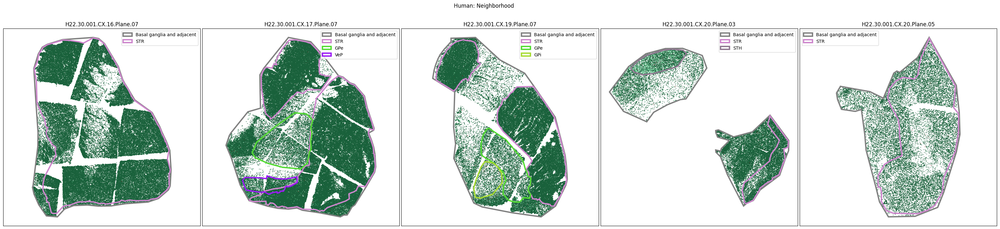

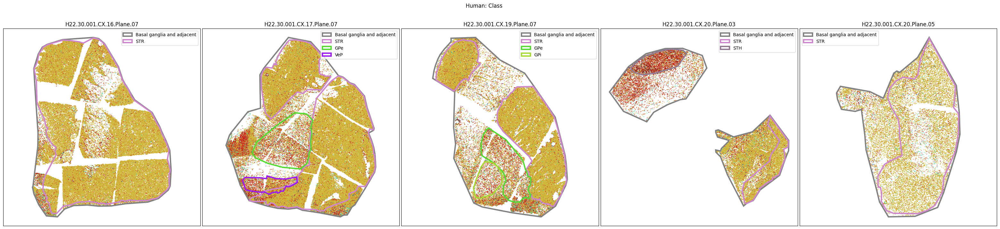

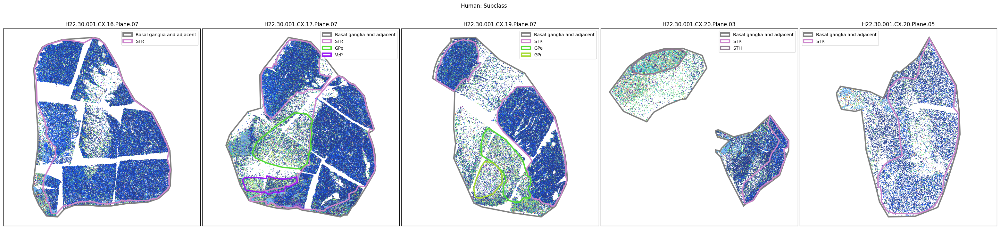

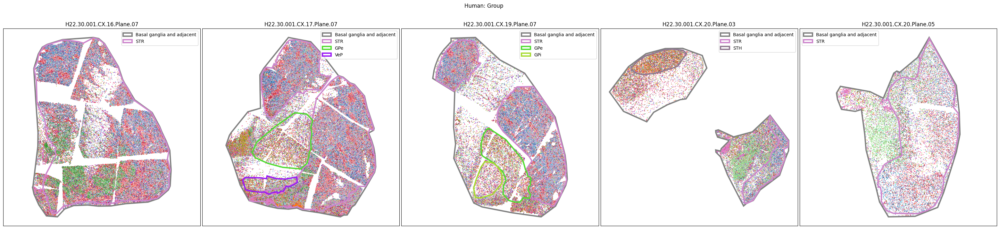

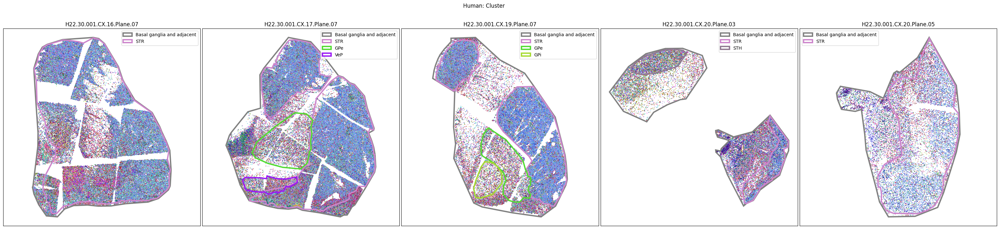

In [32]:
# Filter out Adjacent
# filtered_human_metadata = human_cell_metadata[~(human_cell_metadata['Neighborhood'] == 'Adjacent')]
# Filter out both adjacent and non-neuronal cells.
filtered_human_metadata = human_cell_metadata[
    np.logical_and(~(human_cell_metadata['Neighborhood'] == 'Adjacent'),
                   human_cell_metadata['Neighborhood'] != 'Nonneuron')
]

for color_type in ['Neighborhood_color', 'Class_color', 'Subclass_color', 'Group_color', 'Cluster_color']:
    fig, ax = plot_slabs(
        filtered_human_metadata,
        color_type,
        human_slab_list,
        species='human',
        plot_polygons=True
    )
    fig.suptitle(f'Human: {color_type.split("_")[0]}')
    plt.show()

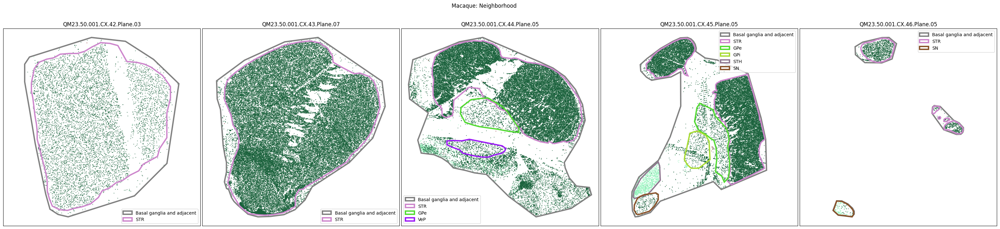

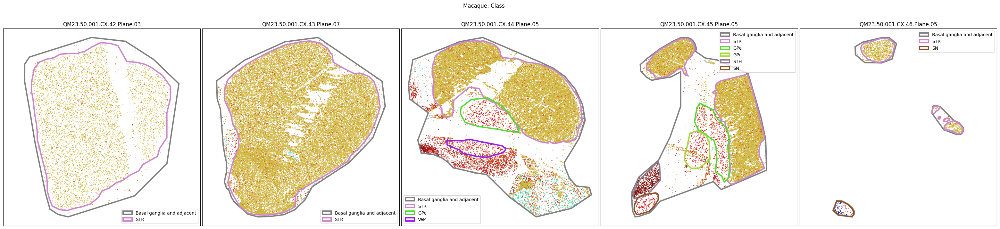

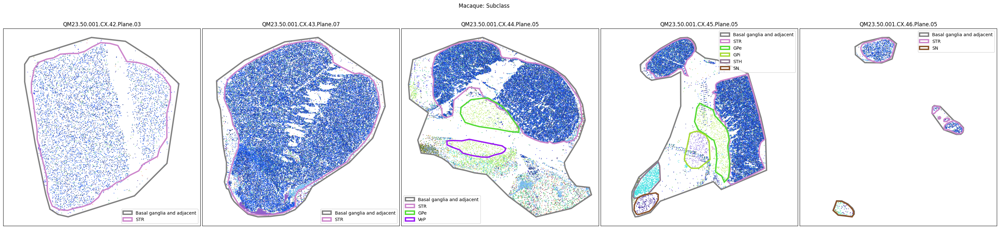

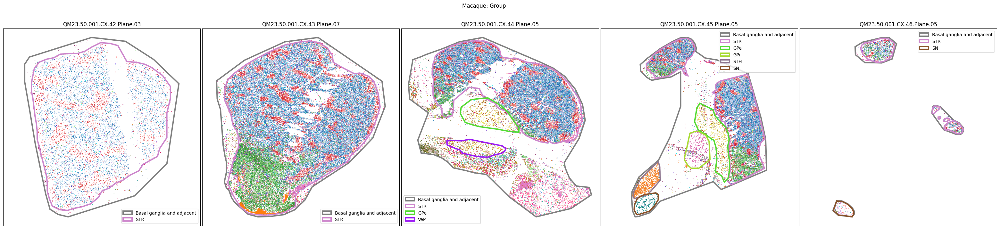

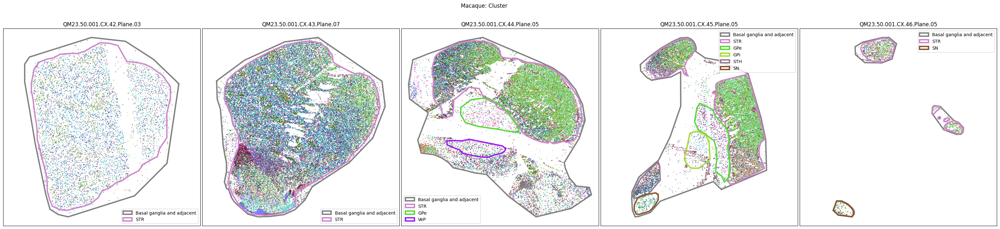

In [33]:
# Filter out Adjacent
# filtered_macaque_metadata = macaque_cell_metadata[~(macaque_cell_metadata['Neighborhood'] == 'Adjacent')]
# Filter out both adjacent and non-neuronal cells.
filtered_macaque_metadata = macaque_cell_metadata[
    np.logical_and(~(macaque_cell_metadata['Neighborhood'] == 'Adjacent'),
                   macaque_cell_metadata['Neighborhood'] != 'Nonneuron')
]
for color_type in ['Neighborhood_color', 'Class_color', 'Subclass_color', 'Group_color', 'Cluster_color']:
    fig, ax = plot_slabs(
        filtered_macaque_metadata,
        color_type,
        macaque_slab_list,
        species='macaque',
        plot_polygons=True
    )
    fig.suptitle(f'Macaque: {color_type.split("_")[0]}')
    plt.show()

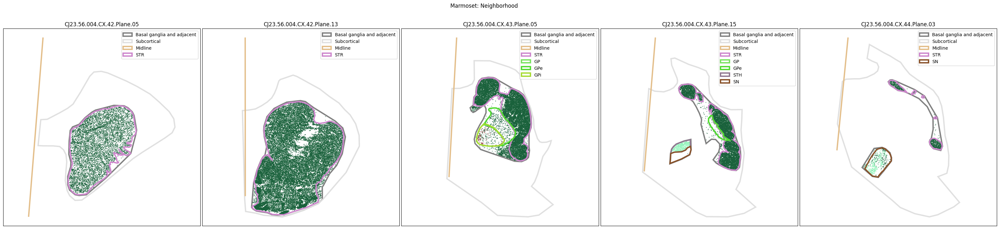

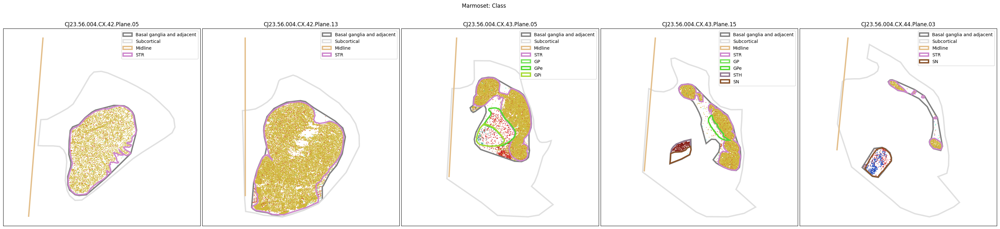

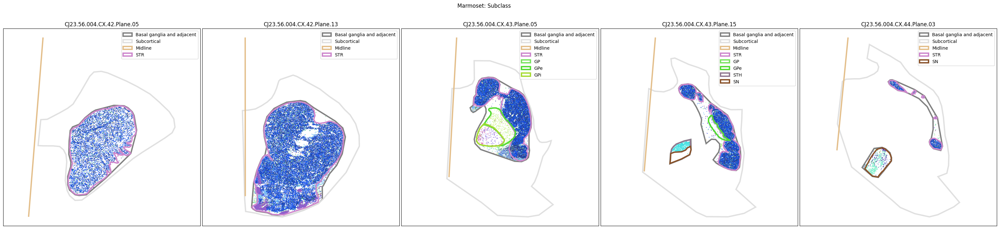

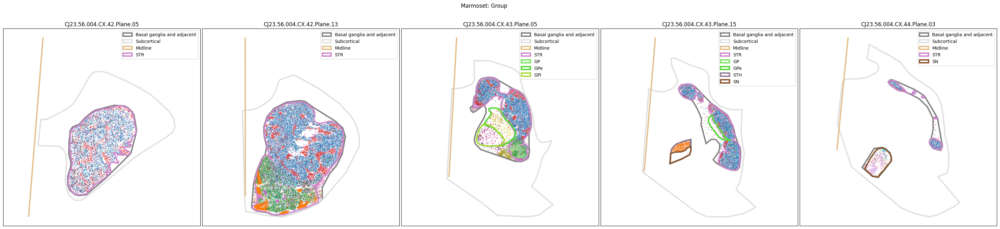

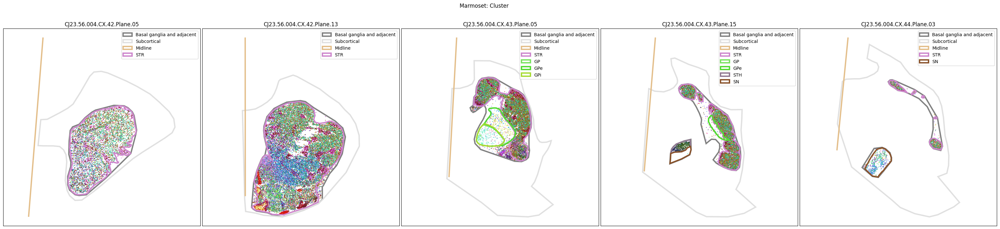

In [34]:
# Filter out Adjacent
# filtered_marmoset_metadata = marmoset_cell_metadata[~(marmoset_cell_metadata['Neighborhood'] == 'Adjacent')]
# Filter out both adjacent and non-neuronal cells.
filtered_marmoset_metadata = marmoset_cell_metadata[
    np.logical_and(~(marmoset_cell_metadata['Neighborhood'] == 'Adjacent'),
                   marmoset_cell_metadata['Neighborhood'] != 'Nonneuron')
]
for color_type in ['Neighborhood_color', 'Class_color', 'Subclass_color', 'Group_color', 'Cluster_color']:
    fig, ax = plot_slabs(
        filtered_marmoset_metadata,
        color_type,
        marmoset_slab_list,
        species='marmoset',
        plot_polygons=True
    )
    fig.suptitle(f'Marmoset: {color_type.split("_")[0]}')
    plt.show()

### Selecting cell types

We define a slightly modified version of our slab plotting function that allows us to plot specific cell types, coloring by cell type level that is nominally lower in the taxonomy. This allows for us to investigate the spatial distribution of cell types more clearly by, for instance, plotting the spatial distributions of Groups within the a Medium Spiny Neuron subclass.

In general, cells associated with individual cell types and taxons can be selected by masking the DataFrame using the desired column and value in that column, as we showed in our examples above. For instance to select the Class, CN LGE GABA, we can create a mask thusly `human_cell_metadata['Class']=='CN LGE GABA'` and similarly for the other species. Again, this function can be used to plot individual slab planes and selections as well.

In [35]:
def plot_selected_cells(
    df: pd.DataFrame,
    feature: str,
    selection_list: List[Tuple[str, str]],
    slab: str,
    species: str,
    cmap: Optional[plt.Colormap] = None,
    fig_width: float = 40,
    fig_height: float = 8,
    plot_polygons: bool = True,
    point_size: float = 1.0,
    fix_bounds: bool = False
):
    """Plot spatial transcriptomics data selected a cell type and colored by
    a feature of interest.

    Parameters
    ----------
    df: pandas.DataFrame
        cell metadata data frame with x,y locations to plot.
    feature: str
        Expression value or color column to plot.
    selection_list: List[str]
        Set of cell types to select by. Specify as ('taxonomy_level_name', 'cell type')
    slab: str
        Specific slab to plot.
    species: str
        Species to plot (human, macaque, marmoset).
    cmap: matplotlib.colors.Colormap
        Colormap for expression features.
    fid_width: int
        Width of the plotted figure.
    fig_height: iont
        Height of the plotted figure.
    plot_polygons: bool
        Overplot geojson polygons. Note that these are note available for human
        and this should be set to False.
    point_size: float
        Size of the points to plot.
    fix_bounds: bool
        If True, fix the x and y bounds across all slabs to be the same.
    """
    
    fig, ax = plt.subplots(1, len(selection_list))
    fig.set_size_inches(fig_width, fig_height)

    if len(selection_list) == 1:
        ax = [ax]

    if 'slab_plane_label' in df.columns:
        slab_filtered = df[df['slab_plane_label']==slab]
    elif 'brain_section_label' in df.columns:
        slab_filtered = df[df['brain_section_label']==slab]

    if 'x' in df.columns:
        x_col = 'x'
    elif 'x_slab_mm' in df.columns:
        x_col = 'x_slab_mm'
    if 'y' in df.columns:
        y_col = 'y'
    elif 'y_slab_mm' in df.columns:
        y_col = 'y_slab_mm'

    if fix_bounds:
        x_min = slab_filtered[x_col].min()
        x_max = slab_filtered[x_col].max()
        y_min = slab_filtered[y_col].min()
        y_max = slab_filtered[y_col].max()
    
    for idx, (col, name) in enumerate(selection_list):

        if 'slab_plane_label' in df.columns:
            filtered = slab_filtered[slab_filtered[col]==name]
        elif 'brain_section_label' in df.columns:
            filtered = slab_filtered[slab_filtered[col]==name]
        xx = filtered[x_col]
        yy = filtered[y_col]
        vv = filtered[feature]
        
        if cmap is not None:
            ax[idx].scatter(xx, yy, s=point_size, c=vv, marker='.', cmap=cmap)
        else :
            ax[idx].scatter(xx, yy, s=point_size, c=vv, marker=".")

        if plot_polygons:
            plot_geo_data(get_polygons(slab, species=species), ax[idx])
            
        ax[idx].axis('equal')
        ylim = ax[idx].get_ylim()
        if fix_bounds:
            ylim = (y_min, y_max)
            ax[idx].set_xlim(x_min, x_max)
        ax[idx].set_ylim(ylim[1], ylim[0])
        ax[idx].set_xticks([])
        ax[idx].set_yticks([])
        
        ax[idx].set_title(name)
        ax[idx].legend(loc=0)
        
    plt.subplots_adjust(wspace=0.01, hspace=0.01)
    fig.suptitle(f'{species}, {slab}')
    return fig, ax

Using the above function, we plot the cells colored by their Group color and select by specific classes and subclasses. We can see commonalities in the distribution across the different species and sections,of the cell types exceptionally clearly.

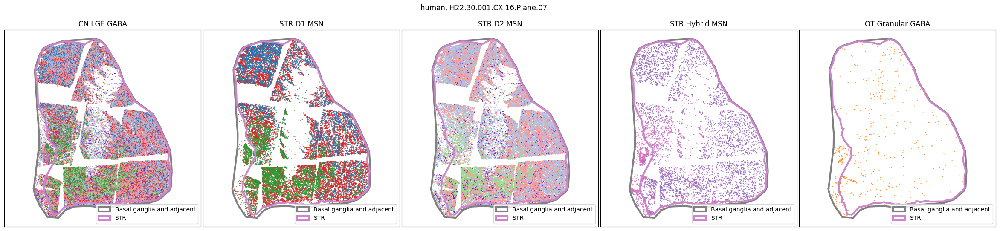

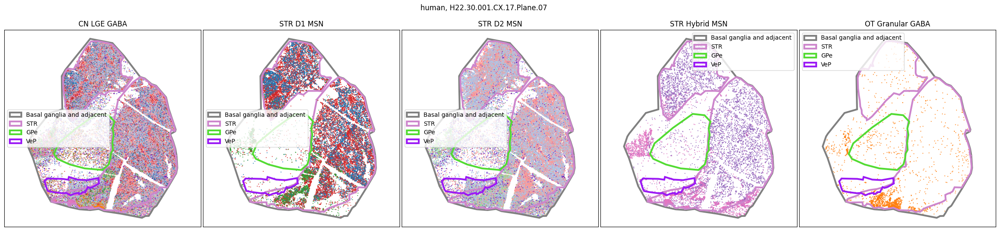

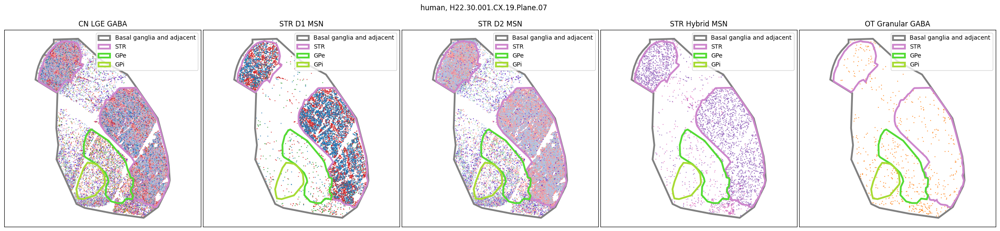

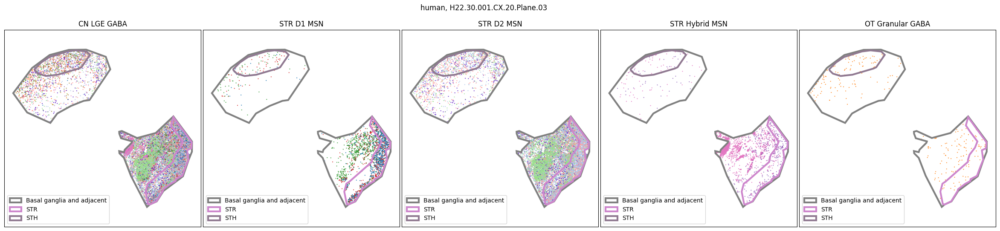

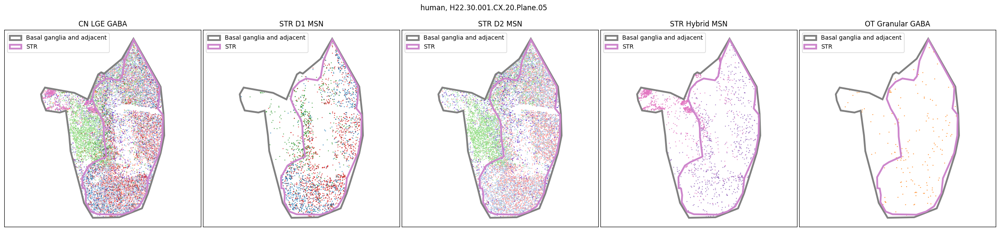

In [36]:
for slab in human_slab_list:
    fig, ax = plot_selected_cells(
        human_cell_metadata,
        feature='Group_color',
        selection_list=[
            ('Class', 'CN LGE GABA'),
            ('Subclass', 'STR D1 MSN'),
            ('Subclass', 'STR D2 MSN'),
            ('Subclass', 'STR Hybrid MSN'),
            ('Subclass', 'OT Granular GABA')
        ],
        slab=slab,
        species='human',
        fig_width=30,
        fig_height=6,
        plot_polygons=True,
    )
    plt.show()

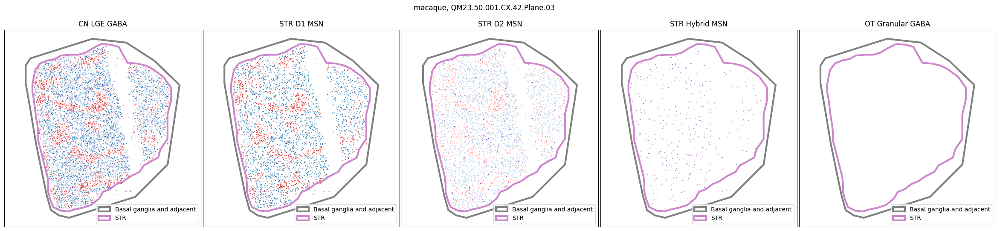

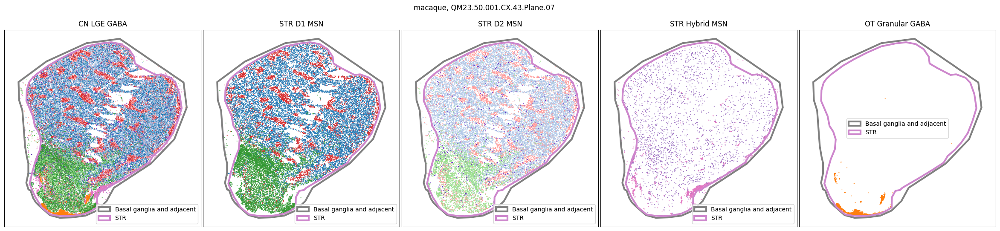

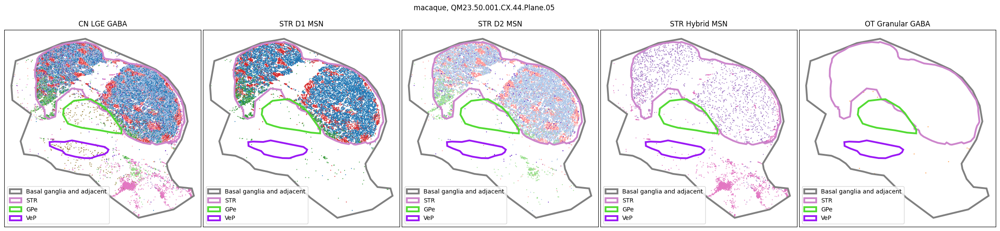

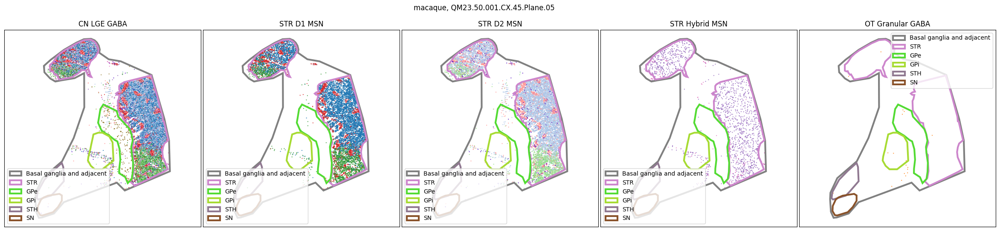

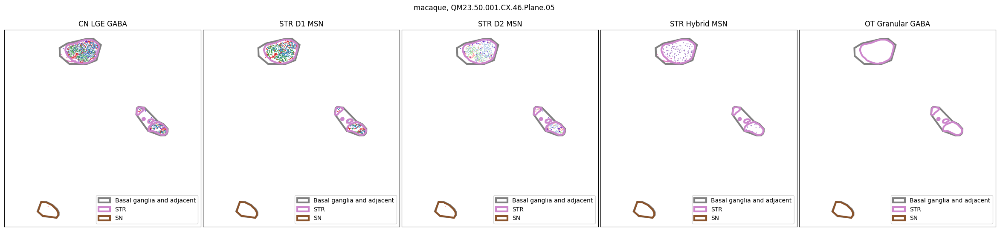

In [37]:
for slab in macaque_slab_list:
    fig, ax = plot_selected_cells(
        macaque_cell_metadata,
        feature='Group_color',
        selection_list=[
            ('Class', 'CN LGE GABA'),
            ('Subclass', 'STR D1 MSN'),
            ('Subclass', 'STR D2 MSN'),
            ('Subclass', 'STR Hybrid MSN'),
            ('Subclass', 'OT Granular GABA')
        ],
        slab=slab,
        species='macaque',
        fig_width=30,
        fig_height=6,
        plot_polygons=True,
    )

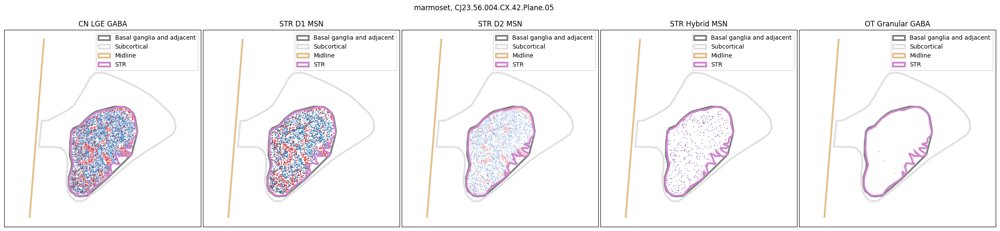

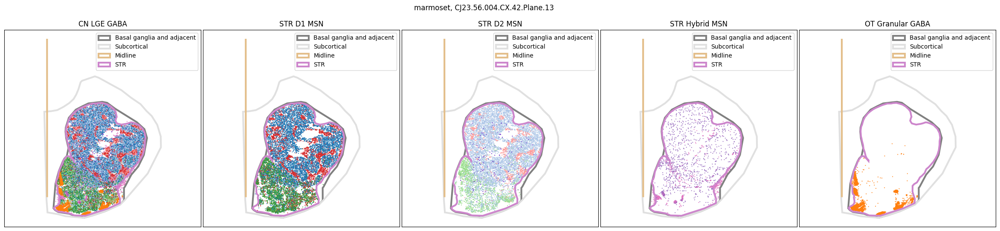

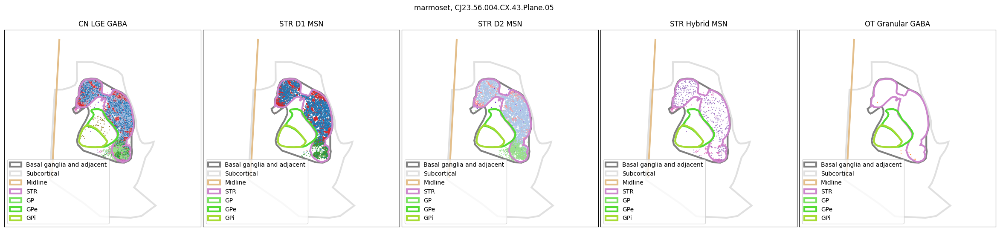

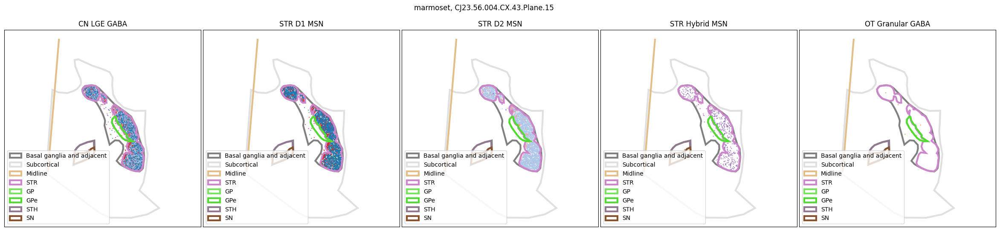

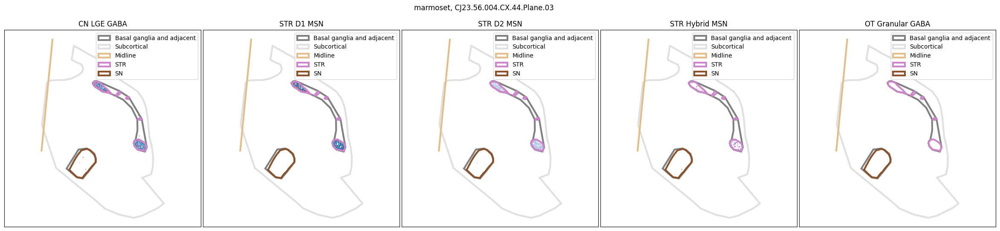

In [38]:
for slab in marmoset_slab_list:
    fig, ax = plot_selected_cells(
        marmoset_cell_metadata,
        feature='Group_color',
        selection_list=[
            ('Class', 'CN LGE GABA'),
            ('Subclass', 'STR D1 MSN'),
            ('Subclass', 'STR D2 MSN'),
            ('Subclass', 'STR Hybrid MSN'),
            ('Subclass', 'OT Granular GABA')
        ],
        slab=slab,
        species='marmoset',
        fig_width=30,
        fig_height=6,
        plot_polygons=True,
    )

In the next tutorial, we will explore [gene expression patterns across these spatial transcriptomics datasets](https://alleninstitute.github.io/abc_atlas_access/notebooks/hmba_bg_spatial_genes.html).

To learn more about the taxonomy used in this notebook and the data it is derived from, see the [HMBA-BG Clustering Analysis and Taxonomy notebook](https://alleninstitute.github.io/abc_atlas_access/notebooks/hmba_bg_clustering_analysis_and_annotation.html).